# Importing all the conversations

This is a bit trickier as you need to do something with all the conversations you're loading up.

In [9]:
from pathlib import Path
from scipy.optimize import curve_fit
from scipy.spatial import ConvexHull
import datetime
import json
import matplotlib as mpl
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import pickle
import re
import seaborn as sns
import textwrap


In [10]:

plt.rcParams['figure.figsize'] = (20, 10)
plt.rcParams['font.sans-serif']=['Segoe UI Emoji']

In [11]:
pickle_name = "all_convo.pickle"
pickle_path = Path(pickle_name)


In [12]:
punctuation_regex = r"""
               [,.;:-@#?!&$/\(\)\n\*]+  # Accept one or more copies of punctuation
               \ *           # plus zero or more copies of a space,
               """
STOP_WORDS = [
        "a", "about", "above", "after", "again", "against", "all", "am", "an", "and", "any", "are", "as", "at", "be", "because", "been", "before", "being", "below", "between", "both", "but", "by", "can", "did", "do", "does", "doing", "don", "down", "during", "each", "few", "for", "from", "further", "had", "has", "have", "having", "he", "her", "here", "hers", "herself", "him", "himself", "his", "how", "http", "https", "i", "i'd", "i'm", "i've", "if", "in", "into", "is", "it", "it's", "its", "itself", "just", "me", "more", "most", "my", "myself", "no", "nor", "not", "now", "of", "off", "on", "once", "only", "or", "other", "our", "ours", "ourselves", "out", "over", "own", "s", "same", "she", "should", "so", "some", "such", "t", "than", "that", "that's", "the", "their", "theirs", "them", "themselves", "then", "there", "these", "they", "this", "those", "through", "to", "too", "under", "until", "up", "very", "was", "we", "were", "what", "when", "where", "which", "while", "who", "whom", "why", "will", "with", "you", "your", "yours", "yourself", "yourselves", "nan", # not a word, accidental cast of NaN
    ]  # https://gist.github.com/sebleier/554280

In [13]:
def parse_obj(obj):
    for key in obj:
        if isinstance(obj[key], str):
            obj[key] = obj[key].encode("latin_1").decode("utf-8")
        elif isinstance(obj[key], list):
            obj[key] = list(
                map(
                    lambda x: x
                    if type(x) != str
                    else x.encode("latin_1").decode("utf-8"),
                    obj[key],
                )
            )
        pass
    return obj


def sumarise_convo(name, data, verbose=False):
    words = {}
    words[name] = data.content.str.cat(sep=" ")
    wordcount = len(words[name].split(" "))

    unique_words = set(words[name].split(" "))

    pool = " ".join([str(x) for x in data.content.to_list()]).lower() 
    clean = re.sub(
        punctuation_regex, " ", pool, flags=re.VERBOSE
    )  # and replace it with a single space
    stopped = list(set([w for w in clean.split() if w not in STOP_WORDS]))

    if verbose:
        print(
            f"{name} wrote {wordcount} words ({len(words[name])} characters)"
            f" and used {len(stopped)} different words."
        )
    return {
        "participant": name,
        "wordcount": wordcount,
        "unique_words": len(unique_words),
        "cleaned_unique": len(stopped),
    }

In [14]:
rootdir = "fb_data/messages/inbox"
conversations = []
for d in os.listdir(rootdir):
    conversations.append(d)
print(f"There are {len(conversations)} conversations to look at.")
# conversations


There are 190 conversations to look at.


In [15]:
def get_message_length(message):
    if type(message) is str:
        return len(message)
    else:
        return len(str(message))


def replace_typographic_apostrophy(message):
    if type(message) is str:
        return message.replace("’", "'")
    else:
        return message


convo_df_list = []

# print(f"\n{name}")
# participants = []
if not pickle_path.is_file():
    for convo in os.listdir(rootdir):
        for f in os.listdir(os.path.join(rootdir, convo)):
            try:
                message_list = []
                path = os.path.join(os.path.join(rootdir, convo, f))
                if Path(path).is_file():
                    with open(path, "r") as fb_data:
                        messages = json.load(fb_data, object_hook=parse_obj)
                        message_list.extend(messages["messages"])

                # print(message_list)
                if len(message_list) != 0:
                    df = pd.DataFrame(message_list)
                    df["source_convo"] = convo
                    df["datetime"] = df.timestamp_ms.apply(
                        lambda x: datetime.datetime.fromtimestamp(x / 1000.0)
                    )

                    df["message_length"] = df.content.apply(get_message_length)
                    df.content = df.content.apply(replace_typographic_apostrophy)

                    convo_df_list.append(df)

            except Exception as e:
                print("excption", convo, e)


excption patriciagrigoriou_im5gnf-jtw 'DataFrame' object has no attribute 'content'


In [16]:
if pickle_path.is_file():
    all_convo_df = pd.read_pickle(pickle_path)
else:
    all_convo_df = pd.concat(convo_df_list)
    pd.to_pickle(all_convo_df, pickle_path)
    all_convo_df.sample(10)


In [17]:
def clean_and_stop(content, as_list=False):
    try:
        clean = re.sub(
        punctuation_regex,
        " ",
        content,
        flags=re.VERBOSE,  # and replace it with a single space
        )
        stopped = [w.lower() for w in clean.split() if w.lower() not in STOP_WORDS]
        # print(content, "=>", stopped)
        if as_list:
            return stopped
        else:
            return " ".join(stopped)
    except Exception as e:
        # print(content, e)
        return content

all_convo_df["clean_content"] = all_convo_df.content.apply(clean_and_stop)


In [18]:
print(all_convo_df.shape)
all_convo_df.head(5)

(39415, 20)


,sender_name,timestamp_ms,content,type,is_unsent,source_convo,datetime,message_length,photos,sticker,ip,call_duration,share,reactions,gifs,videos,audio_files,missed,users,clean_content
0,,1547017013329,넵,Generic,False,nimxf-gelg,2019-01-09 17:56:53.329,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,넵
1,장수영,1547016964711,괜찮아요 다음부터 조심하세요~~,Generic,False,nimxf-gelg,2019-01-09 17:56:04.711,17,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,괜찮아요 다음부터 조심하세요~~
2,,1547016938868,찾았습니다... 감사합니다 정말..,Generic,False,nimxf-gelg,2019-01-09 17:55:38.868,19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,찾았습니다 감사합니다 정말
3,,1547016812510,아지금 3층으로가고있어요,Generic,False,nimxf-gelg,2019-01-09 17:53:32.510,13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,아지금 3층으로가고있어요
4,장수영,1547016791852,찾으셨나요?,Generic,False,nimxf-gelg,2019-01-09 17:53:11.852,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,찾으셨나요


In [19]:
# words = {}
# for name, data in df.groupby("sender_name"):
#     words[name] = data.content.str.cat(sep=" ")
#     wordcount = len(words[name].split(" "))
#     # print(f"{name} wrote {wordcount} words ({len(words[name])} characters)")


In [20]:
conv_meta = []
for name, data in all_convo_df.groupby("sender_name"):
    conv_meta.append( sumarise_convo(name, data))
meta_df = pd.DataFrame(conv_meta)
meta_df["ratio"] = meta_df.apply(lambda row: row.wordcount / (row.cleaned_unique+1) , axis=1)


findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 51109 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 49688 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 50689 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 51109 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 49688 missing from current font.

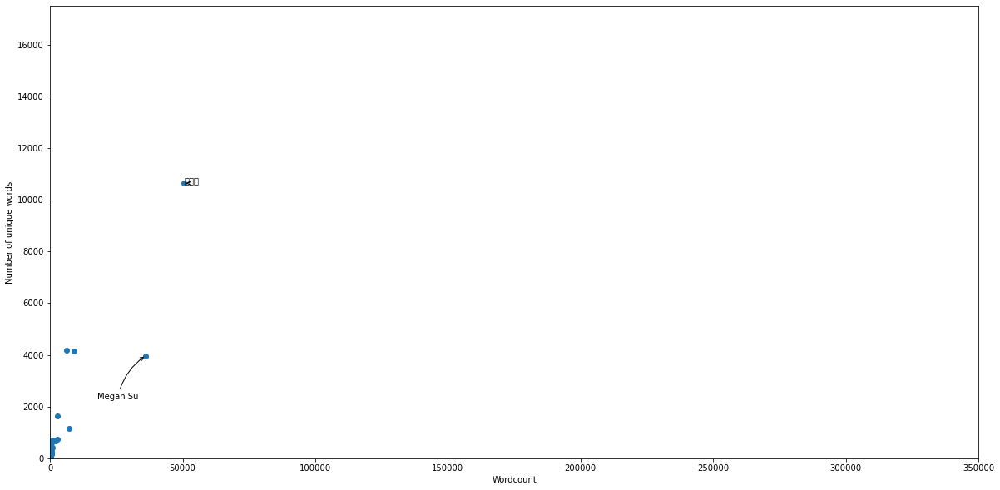

In [21]:
import random

fig = plt.figure()
ax = plt.gca()
# plt.scatter(meta_df.wordcount, meta_df.unique_words)
ax.scatter(meta_df.wordcount, meta_df.cleaned_unique)
plt.xlabel("Wordcount")
plt.ylabel("Number of unique words")
plt.xlim([0, 350000])
plt.ylim([0, 17500])

for i, row in meta_df.iterrows():
    if row.wordcount > 15000:
        # if row.wordcount > 15000:
        #     right = 60
        # else:
        #     right = 500
        plt.annotate(
            row.participant,
            (row.wordcount, row.cleaned_unique),
            size=10,
            xycoords="data",
            xytext=(
                random.randint(50, 130) * random.sample(range(-1, 1), k=1)[0],
                random.randint(50, 60) * random.sample(range(-1, 1), k=1)[0],
            ),
            textcoords="offset points",
            arrowprops=dict(arrowstyle="->", connectionstyle="arc3,rad=-0.2"),
        )

# # define the true objective function
# def objective(x, a, b, c):
# 	return a * x + b * x**2 + c
# x=meta_df.wordcount
# y=meta_df.cleaned_unique
# # curve fit
# popt, _ = curve_fit(objective, x, y)
# # summarize the parameter values
# a, b, c = popt
# print('y = %.5f * x + %.5f * x^2 + %.5f' % (a, b, c))

# # define a sequence of inputs between the smallest and largest known inputs
# x_line = np.arange(min(x), max(x), 1)
# # calculate the output for the range
# y_line = objective(x_line, a, b, c)
# # create a line plot for the mapping function
# plt.plot(x_line, y_line, '--', color='red')


Text(0.5, 1.0, 'Ratio of wordcount to unique words count\n(only showing those with word counts over 5k)')

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 51060 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 44032 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 50689 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 51109 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 49688 missing from current font.
  font.set_text

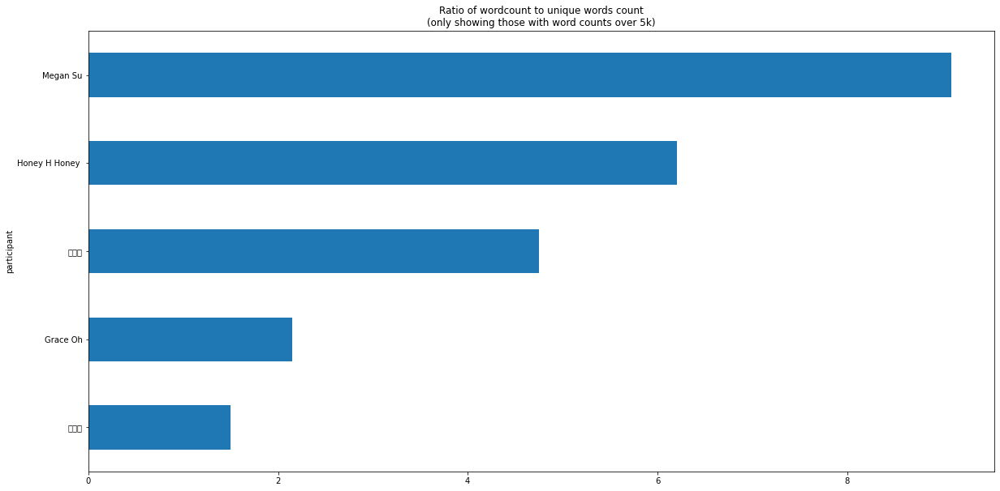

In [22]:
meta_df[meta_df.wordcount>5000].set_index("participant").ratio.sort_values().plot.barh()
plt.title("Ratio of wordcount to unique words count\n(only showing those with word counts over 5k)")

<AxesSubplot:title={'center':'Number of messages sent'}>

/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 51109 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 49688 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 50689 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 51060 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 44032 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3

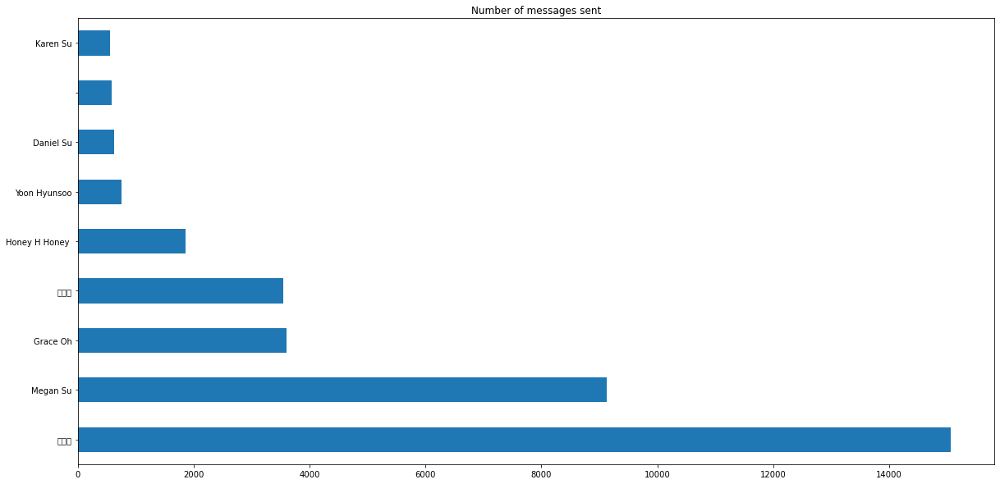

In [23]:
vc = all_convo_df.sender_name.value_counts()
vc[(vc > 500) & (vc < 100000)].plot.barh(
    title="Number of messages sent"
)  # , xlim=(0,6606834)


In [41]:
chatty_people = all_convo_df.sender_name.value_counts() > 100
all_convo_df["chatty_people"] = [chatty_people[x] for x in all_convo_df.sender_name]
all_convo_df.sample(10)


,sender_name,timestamp_ms,content,type,is_unsent,source_convo,datetime,message_length,photos,sticker,...,gifs,videos,audio_files,missed,users,clean_content,chatty_people,date,time,seconds
13,Dingqian Li,1618187923066,I tried to make a basic structure in wk5,Generic,False,dingqianli_ilb8fo3uva,2021-04-12 10:38:43.066,40,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,tried make basic structure wk5,True,2021-04-12,10:38:43.066000,38323
548,이가영,1486542924148,오늘은집일찍왓앙,Generic,False,igayeong_ko9r4gr9tq,2017-02-08 19:35:24.148,8,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,오늘은집일찍왓앙,True,2017-02-08,19:35:24.148000,70524
1384,Megan Su,1529640397526,Lol dw,Generic,False,megansu_zepkvzqqpg,2018-06-22 14:06:37.526,6,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,lol dw,True,2018-06-22,14:06:37.526000,50797
8643,Megan Su,1566887943081,He wants to use tmw,Generic,False,megansu_zepkvzqqpg,2019-08-27 16:39:03.081,19,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,wants use tmw,True,2019-08-27,16:39:03.081000,59943
5365,장수영,1442644047290,Noooooooooo,Generic,False,megansu_zepkvzqqpg,2015-09-19 16:27:27.290,11,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,noooooooooo,True,2015-09-19,16:27:27.290000,59247
17,Una Cha,1505469553990,흠..,Generic,False,unameganandbogyeong_lbxv1xah8q,2017-09-15 19:59:13.990,3,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,흠,False,2017-09-15,19:59:13.990000,71953
458,이승영,1418206733154,난 내생명 한개 뺏다,Generic,False,o_ghiwzl6v_g,2014-12-10 21:18:53.154,11,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,난 내생명 한개 뺏다,True,2014-12-10,21:18:53.154000,76733
1064,장수영,1620014557117,Lol use ur phone,Generic,False,megansu_zepkvzqqpg,2021-05-03 14:02:37.117,16,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,lol use ur phone,True,2021-05-03,14:02:37.117000,50557
5992,장수영,1597383469293,Did u find any?,Generic,False,megansu_zepkvzqqpg,2020-08-14 15:37:49.293,15,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,u find,True,2020-08-14,15:37:49.293000,56269
1477,이가영,1453187883451,NaN,Generic,False,igayeong_ko9r4gr9tq,2016-01-19 18:18:03.451,3,[{'uri': 'messages/inbox/igayeong_ko9r4gr9tq/p...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,True,2016-01-19,18:18:03.451000,65883


# Plotting time that might show sleep

This is a bit nasty, I don't really like it, but it seems to work. There _must_ be a better way.

Convert the time component of the datetime to just-date and just-time (but in seconds, as a number) and then plot that.

The y axis is nasty becasue it doesn't show 

In [42]:
def time_to_seconds(dt):
    t = dt.time()
    seconds = (t.hour * 60 + t.minute) * 60 + t.second
    return seconds


all_convo_df["date"] = all_convo_df.datetime.apply(lambda x: x.date())
all_convo_df["time"] = all_convo_df.datetime.apply(lambda x: x.time())
all_convo_df["seconds"] = all_convo_df.datetime.apply(time_to_seconds)
all_convo_df.sample(5)


,sender_name,timestamp_ms,content,type,is_unsent,source_convo,datetime,message_length,photos,sticker,...,gifs,videos,audio_files,missed,users,clean_content,chatty_people,date,time,seconds
304,Megan Su,1604202482562,Yes because its chronic,Generic,False,karensnewcat_058e_vpu3g,2020-11-01 14:48:02.562,23,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,yes chronic,True,2020-11-01,14:48:02.562000,53282
4552,Grace Oh,1492059687389,NaN,Generic,False,graceoh_xe0pq10crg,2017-04-13 15:01:27.389,3,[{'uri': 'messages/inbox/graceoh_xe0pq10crg/ph...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,True,2017-04-13,15:01:27.389000,54087
9124,장수영,1559532817373,Stilllllll????,Generic,False,megansu_zepkvzqqpg,2019-06-03 13:33:37.373,14,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,stilllllll,True,2019-06-03,13:33:37.373000,48817
76,장수영,1505660765197,아니 한번도 안가봤어 ㅋㅋ,Generic,False,huijin_smprodrjog,2017-09-18 01:06:05.197,14,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,아니 한번도 안가봤어 ㅋㅋ,True,2017-09-18,01:06:05.197000,3965
2717,장수영,1615352238050,i downloaded league again,Generic,False,megansu_zepkvzqqpg,2021-03-10 15:57:18.050,25,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,downloaded league,True,2021-03-10,15:57:18.050000,57438


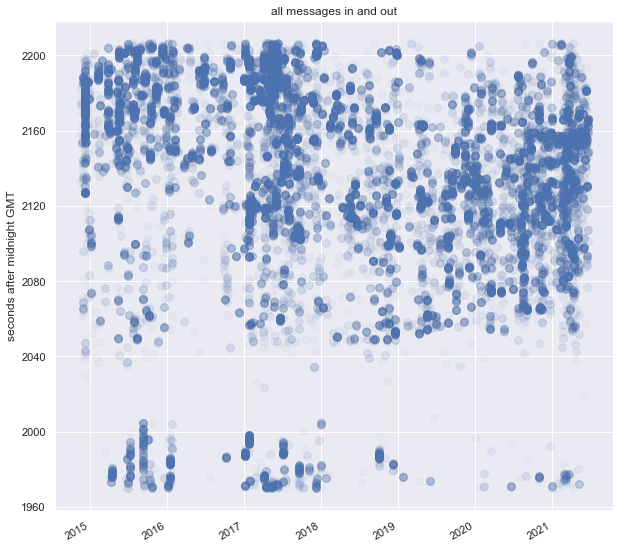

In [43]:
fig = plt.figure()
ax = fig.add_subplot(111)
ax.scatter(
    all_convo_df.date, all_convo_df.seconds, s=60, alpha=0.04
)  # , c=df.sender_name.astype('category').cat.codes)
ax.yaxis_date()
fig.autofmt_xdate()
plt.title("all messages in and out")
plt.ylabel("seconds after midnight GMT")

plt.show()


So, this makes sense to me, but it's a bit gross. The y axis is all messed up, it should be showing time, not number of seconds. I'm also not sure if time goes forward up or down the page.

It'd be good to work out a way of identifying sleep periods. Maybe that's a period that starts after 10pm that's offline for more than 4 hours?

/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 51109 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 49688 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 50689 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 55148 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/backends/backend_agg.py:238: RuntimeWarning: Glyph 51652 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/Users/sooyoungjang/opt/anacon

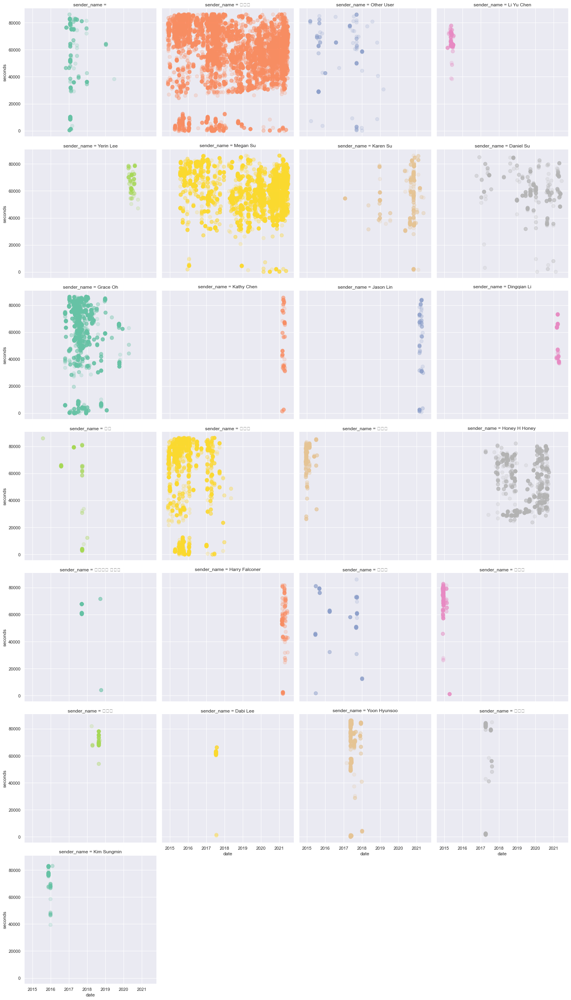

In [44]:
plot = sns.lmplot(
    x="date",
    y="seconds",
    data=all_convo_df[all_convo_df["chatty_people"]],
    # data=all_convo_df,
    hue="sender_name",
    fit_reg=False,
    legend=True,
    palette="Set2",
    col="sender_name",
    col_wrap=4,
    scatter_kws=dict(s=80, alpha=0.2),
)


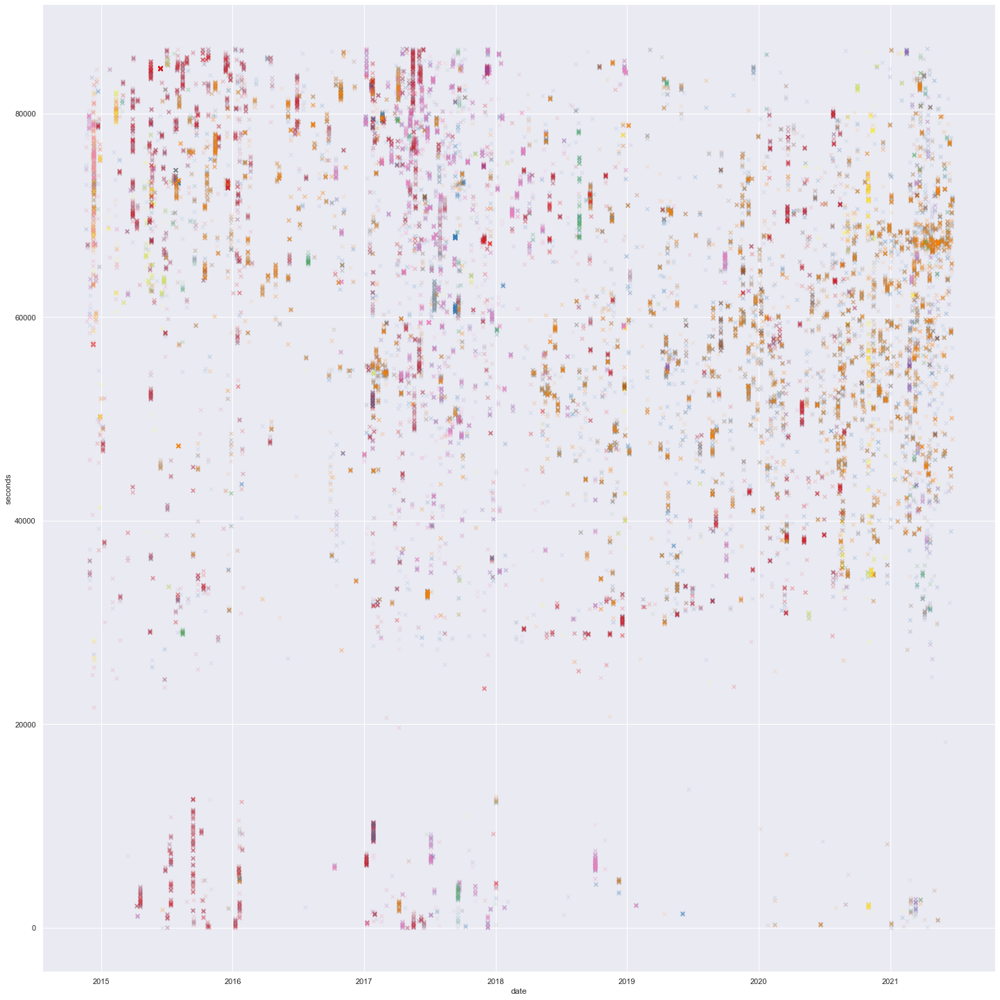

In [45]:
sns.set(rc={"figure.figsize": (15, 15)})
plot = sns.lmplot(
    x="date",
    y="seconds",
    data=all_convo_df[all_convo_df.sender_name != "Ben Doherty"],
    hue="sender_name",
    markers="x",
    fit_reg=False,
    legend=False,
    palette="Set1",
    scatter_kws=dict(s=30, alpha=0.1),
    height=20,
    aspect=20 / 20,
)
# plt.xticks(rotation=45);
plt.savefig("all_incoming.svg")
plt.savefig("all_incoming.png")


In [46]:
data = all_convo_df[all_convo_df.sender_name != "장수영"]
data = data[data.chatty_people]
print(data.shape)
data.sample(3)


(23596, 24)


,sender_name,timestamp_ms,content,type,is_unsent,source_convo,datetime,message_length,photos,sticker,...,gifs,videos,audio_files,missed,users,clean_content,chatty_people,date,time,seconds
2335,Megan Su,1616042847611,Hey,Generic,False,megansu_zepkvzqqpg,2021-03-18 15:47:27.611,3,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,hey,True,2021-03-18,15:47:27.611000,56847
8391,Megan Su,1571531717536,U havent been talking to me these days either,Generic,False,megansu_zepkvzqqpg,2019-10-20 11:35:17.536,45,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,u havent talking days either,True,2019-10-20,11:35:17.536000,41717
8611,Megan Su,1566981570972,Hey,Generic,False,megansu_zepkvzqqpg,2019-08-28 18:39:30.972,3,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,hey,True,2019-08-28,18:39:30.972000,67170


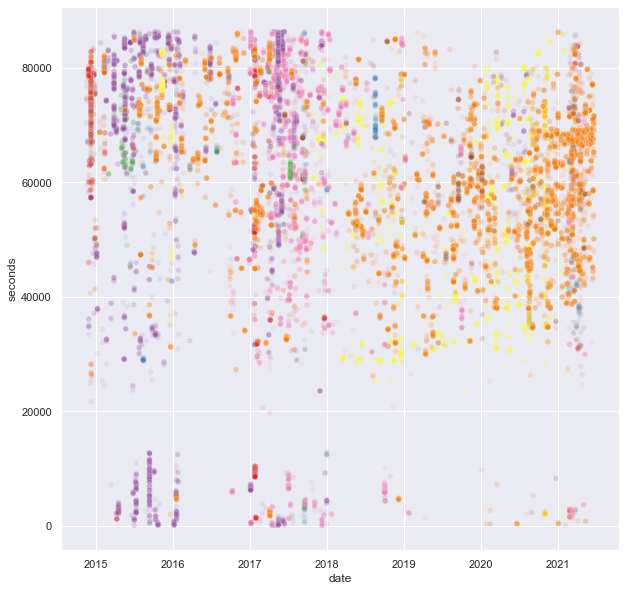

In [47]:
sns.set(rc={"figure.figsize": (10, 10)})
fig, ax = plt.subplots()
g = sns.scatterplot(
    x="date",
    y="seconds",
    data=data,
    hue="sender_name",
    legend=False,
    palette="Set1",
    s=30,
    alpha=0.1,
    ax=ax,
)
# g.legend(bbox_to_anchor=(1.5, 1))

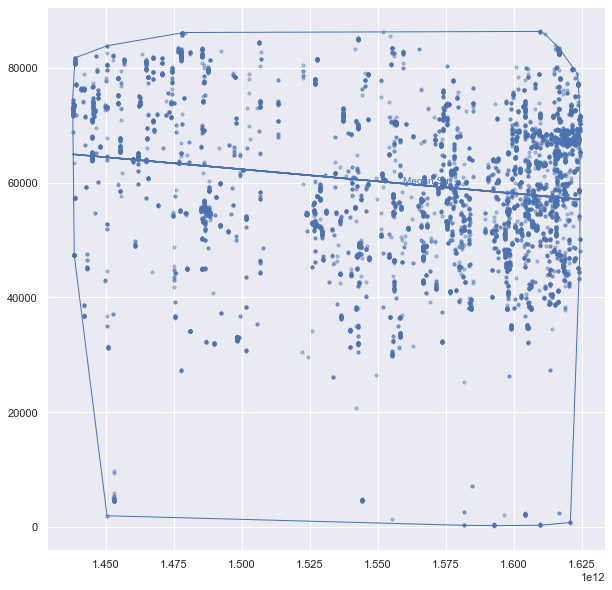

In [48]:
def encircle(x,y, ax=None, **kw):
    if not ax: ax=plt.gca()
    p = np.c_[x,y]
    hull = ConvexHull(p)
    poly = plt.Polygon(p[hull.vertices,:], **kw)
    ax.add_patch(poly)


fig, ax = plt.subplots()
for x, d in data.groupby("sender_name"):
    if d.shape[0]>4000:
        m, b = np.polyfit(d.timestamp_ms, d.seconds, 1)
        plt.plot(d.timestamp_ms, m*d.timestamp_ms + b)
        col=plt.gca().lines[-1].get_color()
        sc = ax.scatter(d.timestamp_ms, d.seconds, s=10, alpha=0.4, label=x, color=col)
        encircle(d.timestamp_ms, d.seconds, ax=ax, ec=col, fc="none")
        plt.annotate(x, (d.timestamp_ms.mean(), d.seconds.mean()), size=10, color=col)

plt.show()


Text(0.5, 1.0, 'Messages sent per Month')

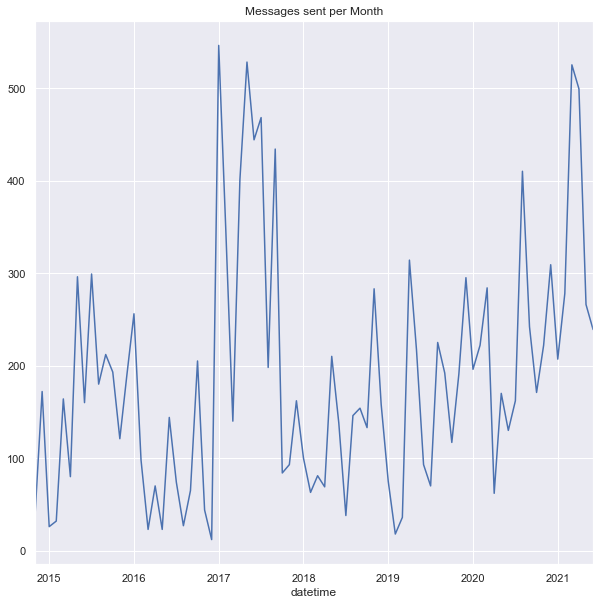

In [49]:
bd_out_df = all_convo_df[all_convo_df.sender_name == "장수영"]
bd_out_df.set_index("datetime").groupby(pd.Grouper(freq="M")).count().sender_name.plot()
plt.title("Messages sent per Month")

/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 49569 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 51452 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 50672 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 50976 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3.8/site-packages/matplotlib/textpath.py:74: RuntimeWarning: Glyph 54788 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)
/Users/sooyoungjang/opt/anaconda3/lib/python3

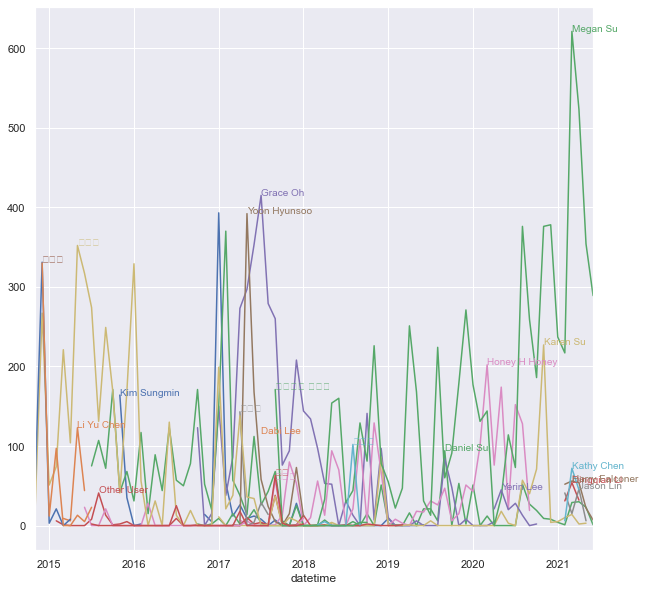

In [50]:
fig, ax = plt.subplots()
for x, d in data.groupby("sender_name"):
    if d.shape[0]>50:
        per_period = d.set_index("datetime").groupby(pd.Grouper(freq="m")).count().sender_name
        per_period.plot()
        col=plt.gca().lines[-1].get_color()
        plt.annotate(x, (per_period.idxmax(), per_period.max()), size=10, color=col)